# Estudio completo de un problema de ML con Python
### Estimación del precio de una vivienda 

En este notebook haremos un análisis exploratorio básico de la base de datos de viviendas de airbnb.

In [1]:
import numpy  as np  
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

## 1. Carga de datos y división train/test

### Cargamos Datos

In [2]:
house_data_unprocessed = pd.read_csv("./data/airbnb-listings-extract.csv",delimiter = ';') # cargamos fichero
print(house_data_unprocessed.shape)

pd.options.display.max_columns = None #Vemos todas las columnas

#Quitamos la columna de urls ya que no nos va a aportar ninguna información
house_data=house_data_unprocessed.drop(columns=['Listing Url','Thumbnail Url','Medium Url','Picture Url','XL Picture Url',
'Host URL','Host Thumbnail Url','Host Picture Url'])

print(house_data.shape)
house_data.head(5)

(14780, 89)
(14780, 81)


,ID,Scrape ID,Last Scraped,Name,Summary,Space,Description,Experiences Offered,Neighborhood Overview,Notes,Transit,Access,Interaction,House Rules,Host ID,Host Name,Host Since,Host Location,Host About,Host Response Time,Host Response Rate,Host Acceptance Rate,Host Neighbourhood,Host Listings Count,Host Total Listings Count,Host Verifications,Street,Neighbourhood,Neighbourhood Cleansed,Neighbourhood Group Cleansed,City,State,Zipcode,Market,Smart Location,Country Code,Country,Latitude,Longitude,Property Type,Room Type,Accommodates,Bathrooms,Bedrooms,Beds,Bed Type,Amenities,Square Feet,Price,Weekly Price,Monthly Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Calendar Updated,Has Availability,Availability 30,Availability 60,Availability 90,Availability 365,Calendar last Scraped,Number of Reviews,First Review,Last Review,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,License,Jurisdiction Names,Cancellation Policy,Calculated host listings count,Reviews per Month,Geolocation,Features
0,11210388,20170306202425,2017-03-07,The Loft-Full Bath-Deck w/View,Loft in the Hill country 12-15 minutes directl...,This loft has a spectacular view of the hills ...,Loft in the Hill country 12-15 minutes directl...,none,This neighborhood is located in the hills west...,The loft is located on a gated property. Ther...,There is no public transportation from this lo...,The loft is entirely private to the guest as i...,My wife and I live on the property so we would...,The loft is entirely private but is adjacent t...,58386783,John,2016-02-11,My father was USAF so I was born at Offutt AFB...,I am a High Tech Professional with over 30 yea...,within an hour,100.0,NaN,NaN,1.0,1.0,"email,phone,reviews,kba","Canyon Edge Drive, Austin, TX 78733, United St...",NaN,78733,NaN,Austin,TX,78733,Austin,"Austin, TX",US,United States,30.337361,-97.863277,Loft,Entire home/apt,2,1.0,1.0,1.0,Real Bed,"TV,Cable TV,Internet,Wireless Internet,Air con...",NaN,58.0,NaN,NaN,100.0,NaN,1,0,2,1125,today,NaN,10,34,64,281,2017-03-06,42,2016-03-13,2017-02-26,98.0,10.0,10.0,10.0,10.0,10.0,10.0,NaN,NaN,moderate,1.0,3.50,"30.3373609355,-97.8632766782","Host Is Superhost,Host Has Profile Pic,Host Id..."
1,17471131,20170407214050,2017-04-08,"Claris I, Friendly Rentals","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...",none,Plaza Cataluña Catalonia Square is the large...,NaN,Ideal to discover the city either on foot or b...,Travellers will have access to the entire apar...,We will be more than happy to help you with an...,CHECK-IN Week Days: The check-in and key colle...,102947901,Claudia,2016-11-08,"Barcelona, Catalonia, Spain",Hola a todos! Soy Claudia Castillo y soy parte...,within an hour,100.0,NaN,NaN,162.0,162.0,"email,phone,reviews,work_email","Barcelona, Barcelona 08010, Spain",NaN,la Dreta de l'Eixample,Eixample,Barcelona,Barcelona,08010,Barcelona,"Barcelona, Spain",ES,Spain,41.389683,2.172625,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"Wireless Internet,Air conditioning,Elevator in...",NaN,70.0,NaN,NaN,200.0,40.0,2,44,1,1125,today,NaN,6,21,39,309,2017-04-08,1,2017-03-05,2017-03-05,80.0,8.0,10.0,10.0,10.0,8.0,10.0,HUTB-006721,NaN,super_strict_30,106.0,0.86,"41.3896829422,2.17262543017","Host Has Profile Pic,Requires License,Instant ..."
2,17584891,20170407214050,2017-04-08,"Style Terrace Red, Friendly Rentals","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...",none,Plaza Cataluña Catalonia Square is the large...,NaN,Ideal to discover the city either on foot or b...,Travellers will have access to the entire apar...,We will be more than happy to help you with an...,CHECK-IN Week Days: The check-in and key colle..

### Dividimos y guardámos datos

In [3]:
from sklearn.model_selection import train_test_split

full_df = house_data
train, test = train_test_split(full_df, test_size=0.2, shuffle=True, random_state=0)

print(f'Dimensiones del dataset de training: {train.shape}')
print(f'Dimensiones del dataset de test: {test.shape}')

# Guardamos
train.to_csv('./data/airbnb-listings-extract_train.csv', sep=';', decimal='.', index=False)
test.to_csv('./data/airbnb-listings-extract_test.csv', sep=';', decimal='.', index=False)

# A partir de este momento cargamos el dataset de train y trabajamos ÚNICAMENTE con él. 

house_data = pd.read_csv('./data/airbnb-listings-extract_train.csv', sep=';', decimal='.')
house_data.head(5).T

Dimensiones del dataset de training: (11824, 81)
Dimensiones del dataset de test: (2956, 81)


,0,1,2,3,4
ID,5994463,14136180,15520134,8809721,1162707
Scrape ID,20170407214119,20170407214119,20170407214119,20170407214119,20170407214119
Last Scraped,2017-04-08,2017-04-08,2017-04-08,2017-04-08,2017-04-08
Name,PISO ATOCHA- FLAT NEAR ATOCHA .,The Palace Sol Madrid.,por persona la noche metro linea5 vista alegre,CITY CENTER JACINTO BENAVENTE ROOM4,NICE & BIG DOUBLE ROOM AT DOWNTOWN
Summary,Piso recién reformado cómoda habitación con ba...,"Lugares de interés: Plaza Mayor, Plaza del Sol...","我的房源靠近餐厅和餐饮、适合家庭的活动、公共交通。因为舒适的床、温馨、厨房、景观,您一定会爱...",This stunning and amazig room is covered with ...,NaN
...,...,...,...,...,...
Cancellation Policy,moderate,flexible,moderate,strict,strict
Calculated host listings count,2.0,1.0,16.0,97.0,2.0
Reviews per Month,0.5,2.43,NaN,NaN,2.08
Geolocation,"40.4077318793,-3.68481869733","40.4158022422,-3.70534037765","40.3890481626,-3.74037392557","40.4128140929,-3.70305247638","40.4386311984,-3.71371613279"


## 2. Análisis exploratorio

Podemos analizar la estructura básica del dataset con las funciones de Pandas que ya conocemos: `describe`, `dtypes`, `shape`, etc.

In [4]:
house_data.describe()

,ID,Scrape ID,Host ID,Host Response Rate,Host Listings Count,Host Total Listings Count,Latitude,Longitude,Accommodates,Bathrooms,Bedrooms,Beds,Square Feet,Price,Weekly Price,Monthly Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Availability 30,Availability 60,Availability 90,Availability 365,Number of Reviews,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,Calculated host listings count,Reviews per Month
count,1.182400e+04,1.182400e+04,1.182400e+04,10317.000000,11821.000000,11821.000000,11824.000000,11824.000000,11824.000000,11780.000000,11804.00000,11787.000000,474.000000,11809.000000,2881.000000,2869.000000,5052.000000,6974.000000,11824.000000,11824.000000,11824.000000,11824.000000,11824.000000,11824.000000,11824.000000,11824.000000,11824.000000,9163.000000,9143.000000,9148.000000,9136.000000,9147.000000,9133.000000,9132.000000,11820.000000,9285.000000
mean,1.025308e+07,2.017038e+13,3.588310e+07,94.803722,12.754420,12.754420,40.491628,-3.776863,3.277486,1.285229,1.34429,2.049122,396.489451,73.712592,378.437348,1432.390728,189.312154,32.073129,1.581614,7.637601,3.109946,961.732070,8.949002,22.949256,39.803958,202.217185,22.664834,91.628179,9.410040,9.320726,9.623905,9.647863,9.534655,9.211345,9.615313,1.873326
std,5.566485e+06,5.505346e+08,3.411993e+07,15.247078,34.578895,34.578895,4.701030,14.014695,2.093973,0.664691,0.90518,1.623489,671.125823,71.624844,194.751472,1236.992934,116.011858,31.278032,1.160518,12.373491,13.427477,9387.640642,9.340334,19.762734,29.663314,128.006830,38.092338,9.137614,0.938013,1.004472,0.804050,0.765450,0.770421,0.963131,23.795580,1.869157
min,1.986400e+04,2.016010e+13,1.745300e+04,0.000000,0.000000,0.000000,-37.851182,-123.124429,1.000000,0.000000,0.00000,1.000000,0.000000,9.000000,70.000000,250.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,0.020000
25%,5.510692e+06,2.017041e+13,6.855490e+06,100.000000,1.000000,1.000000,40.409758,-3.707538,2.000000,1.000000,1.00000,1.000000,0.000000,34.000000,220.000000,720.000000,100.000000,15.000000,1.000000,0.000000,1.000000,365.000000,0.000000,4.000000,11.000000,78.000000,1.000000,89.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,1.000000,0.450000
50%,1.125754e+07,2.017041e+13,2.454770e+07,100.000000,2.000000,2.000000,40.419331,-3.700763,3.000000,1.000000,1.00000,2.000000,90.000000,55.000000,350.000000,1200.000000,150.000000,25.000000,1.000000,0.000000,2.000000,1125.000000,6.000000,20.000000,38.000000,240.000000,7.000000,94.000000,10.000000,10.000000,10.000000,10.000000,10.000000,9.000000,2.000000,1.210000
75%,1.531982e+07,2.017041e+13,5.431096e+07,100.000000,6.000000,6.000000,40.430778,-3.683917,4.000000,1.000000,2.00000,2.000000,624.000000,87.000000,500.000000,1750.000000,200.000000,40.000000,2.000000,15.000000,3.000000,1125.000000,14.000000,38.000000,65.000000,319.000000,27.000000,98.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,5.000000,2.780000
max,1.858361e+07,2.017062e+13,1.247534e+08,100.000000,519.000000,519.000000,55.966912,153.371427,16.000000,8.000000,10.00000,16.000000,6997.000000,969.000000,999.000000,25000.000000,990.000000,662.000000,16.000000,500.000000,1125.000000,1000000.000000,30.000000,60.000000,90.000000,365.000000,356.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,145.000000,17.210000


In [5]:
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11824 entries, 0 to 11823
Data columns (total 81 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ID                              11824 non-null  int64  
 1   Scrape ID                       11824 non-null  int64  
 2   Last Scraped                    11824 non-null  object 
 3   Name                            11823 non-null  object 
 4   Summary                         11355 non-null  object 
 5   Space                           8718 non-null   object 
 6   Description                     11818 non-null  object 
 7   Experiences Offered             11824 non-null  object 
 8   Neighborhood Overview           7309 non-null   object 
 9   Notes                           4543 non-null   object 
 10  Transit                         7243 non-null   object 
 11  Access                          6663 non-null   object 
 12  Interaction                     

In [6]:
# Mostramos estadísticas descriptivas
# Separamos las columnas numéricas y categóricas para luego decir como rellenaremos sus nulos
numerical_cols = house_data.select_dtypes(include=['number']).columns.tolist()
categorical_cols = house_data.select_dtypes(include=['object', 'category']).columns.tolist()

print(categorical_cols)

numerical_more_than_10 = [] # Dividimos las categóricas en las que tienen más de 10 valores distintos
numerical_less_equal_10 = [] # Y los que tienen menos de 10 valores distintos

for col in numerical_cols:
    unique_values = house_data[col].nunique()
    if unique_values > 10:
        numerical_more_than_10.append(col)
    else:
        numerical_less_equal_10.append(col)

['Last Scraped', 'Name', 'Summary', 'Space', 'Description', 'Experiences Offered', 'Neighborhood Overview', 'Notes', 'Transit', 'Access', 'Interaction', 'House Rules', 'Host Name', 'Host Since', 'Host Location', 'Host About', 'Host Response Time', 'Host Acceptance Rate', 'Host Neighbourhood', 'Host Verifications', 'Street', 'Neighbourhood', 'Neighbourhood Cleansed', 'Neighbourhood Group Cleansed', 'City', 'State', 'Zipcode', 'Market', 'Smart Location', 'Country Code', 'Country', 'Property Type', 'Room Type', 'Bed Type', 'Amenities', 'Calendar Updated', 'Has Availability', 'Calendar last Scraped', 'First Review', 'Last Review', 'License', 'Jurisdiction Names', 'Cancellation Policy', 'Geolocation', 'Features']


In [7]:
# Función para detectar outliers utilizando el método IQR
def detect_outliers(df, cols):
    columns_with_outliers = []
    columns_without_outliers = []
    
    for col in cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
        
        if not outliers.empty:
            columns_with_outliers.append(col)
        else:
            columns_without_outliers.append(col)
    
    return columns_with_outliers, columns_without_outliers

# Detectamos si las columnas numéricas con más de 10 valores distintos que tienen outliers
columns_with_outliers, columns_without_outliers = detect_outliers(house_data, numerical_more_than_10)

print("Columnas con outliers:", columns_with_outliers)
print("Columnas sin outliers:", columns_without_outliers)

Columnas con outliers: ['Scrape ID', 'Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Latitude', 'Longitude', 'Accommodates', 'Bathrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Guests Included', 'Extra People', 'Minimum Nights', 'Maximum Nights', 'Number of Reviews', 'Review Scores Rating', 'Calculated host listings count', 'Reviews per Month']
Columnas sin outliers: ['ID', 'Host ID', 'Availability 30', 'Availability 60', 'Availability 90', 'Availability 365']


In [8]:
# Mirámos también que columnas contienen valores nulos
null_check = house_data.isnull().any()
columns_with_nulls = null_check[null_check].index.tolist()

print(columns_with_nulls)

['Name', 'Summary', 'Space', 'Description', 'Neighborhood Overview', 'Notes', 'Transit', 'Access', 'Interaction', 'House Rules', 'Host Name', 'Host Since', 'Host Location', 'Host About', 'Host Response Time', 'Host Response Rate', 'Host Acceptance Rate', 'Host Neighbourhood', 'Host Listings Count', 'Host Total Listings Count', 'Host Verifications', 'Neighbourhood', 'Neighbourhood Group Cleansed', 'City', 'State', 'Zipcode', 'Market', 'Country', 'Bathrooms', 'Bedrooms', 'Beds', 'Amenities', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Has Availability', 'First Review', 'Last Review', 'Review Scores Rating', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value', 'License', 'Jurisdiction Names', 'Calculated host listings count', 'Reviews per Month', 'Features']


In [9]:
# Función para encontrar los elementos comunes entre dos listas
def find_common_elements(list1, list2):
    return [col for col in list1 if col in list2]

# Ahora para poder decidir como rellenamos clasificamos las columnas en función de si tienen nulos y/o outliers

# Columnas numéricas con más de 10 valores distintos
columns_with_outliers_nulls = find_common_elements(columns_with_outliers, columns_with_nulls)
columns_without_outliers_nulls = find_common_elements(columns_without_outliers, columns_with_nulls)

numerical_less_equal_10_nulls = find_common_elements(numerical_less_equal_10, columns_with_nulls)
categorical_cols_nulls = find_common_elements(categorical_cols, columns_with_nulls)

# Impresión de las nuevas listas
print("columns_with_outliers_nulls:", columns_with_outliers_nulls)
print("columns_without_outliers_nulls:", columns_without_outliers_nulls)
print("numerical_less_equal_10_nulls:", numerical_less_equal_10_nulls)
print("categorical_cols_nulls:", categorical_cols_nulls)

columns_with_outliers_nulls: ['Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Bathrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Review Scores Rating', 'Calculated host listings count', 'Reviews per Month']
columns_without_outliers_nulls: []
numerical_less_equal_10_nulls: ['Bedrooms', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value']
categorical_cols_nulls: ['Name', 'Summary', 'Space', 'Description', 'Neighborhood Overview', 'Notes', 'Transit', 'Access', 'Interaction', 'House Rules', 'Host Name', 'Host Since', 'Host Location', 'Host About', 'Host Response Time', 'Host Acceptance Rate', 'Host Neighbourhood', 'Host Verifications', 'Neighbourhood', 'Neighbourhood Group Cleansed', 'City', 'State', 'Zipcode', 'Market', 'Country', 'Amenities', 'Has Availability', 'First Review', 'Last Review', '

#### Imputación

Ya tenemos toda la información preparada para imputar los valores nulos, para ello lo que haremos es lo siguiente:
1. Columnas numéricas con outliers y con nulos y teniendo más de 10 valores distintos: los rellenaremos con la mediana ya que así no nos perjudican estos outliers.
2. Columnas numéricas sin outliers y con nulos y teniendo más de 10 valores distintos: los rellenaremos con la media, ya que al no tener outliers la media es más efectiva. En este caso no tenemos.
3. Para las columnas categóricas: rellenaremos los nulos con 'Desconocido' y después las codificaremos.
4. Columnas numéricas con nulos y teniendo menos de 10 valores distintos: los rellenaremos con la moda.

In [10]:
# Iteramos sobre cada columna en la lista y rellenamos los nulos con la mediana
for column in columns_with_outliers_nulls:
    house_data[column].fillna(house_data[column].median(), inplace=True) 

# Iteramos sobre cada columna en la lista y rellenamos los nulos con la moda
for column in numerical_less_equal_10_nulls:
    house_data[column].fillna(house_data[column].mode()[0], inplace=True)
pd.set_option('display.max_rows', None)

house_data.isnull().any()

ID                                False
Scrape ID                         False
Last Scraped                      False
Name                               True
Summary                            True
Space                              True
Description                        True
Experiences Offered               False
Neighborhood Overview              True
Notes                              True
Transit                            True
Access                             True
Interaction                        True
House Rules                        True
Host ID                           False
Host Name                          True
Host Since                         True
Host Location                      True
Host About                         True
Host Response Time                 True
Host Response Rate                False
Host Acceptance Rate               True
Host Neighbourhood                 True
Host Listings Count               False
Host Total Listings Count         False


Nos queda rellenar los valores nulos de las variables categóricas.

#### Codificación de variables categóricas

Pasamos a realizar la codificación de las variables categóricas.

In [11]:
!pip install category_encoders

In [12]:
from category_encoders import TargetEncoder
import pandas as pd

# Sustituimos los nulos por 'Desconocido'
house_data[categorical_cols] = house_data[categorical_cols].fillna('Desconocido')

# Especificamos la variable objetivo
variable_objetivo = 'Price'  

# Aplicamos TargetEncoder
encoder = TargetEncoder(cols=categorical_cols)
house_data_encoded = encoder.fit_transform(house_data, house_data[variable_objetivo])

# Guardamos los datos codificados
house_data_encoded.to_csv('./data/archivo_codificado.csv', index=False)


Revisamos que efectivamente nos ha quedado un dataset sin nulos y todo con números.

In [13]:
house_data_encoded.isnull().any()

ID                                False
Scrape ID                         False
Last Scraped                      False
Name                              False
Summary                           False
Space                             False
Description                       False
Experiences Offered               False
Neighborhood Overview             False
Notes                             False
Transit                           False
Access                            False
Interaction                       False
House Rules                       False
Host ID                           False
Host Name                         False
Host Since                        False
Host Location                     False
Host About                        False
Host Response Time                False
Host Response Rate                False
Host Acceptance Rate              False
Host Neighbourhood                False
Host Listings Count               False
Host Total Listings Count         False


In [14]:
house_data_encoded.head(50)

,ID,Scrape ID,Last Scraped,Name,Summary,Space,Description,Experiences Offered,Neighborhood Overview,Notes,Transit,Access,Interaction,House Rules,Host ID,Host Name,Host Since,Host Location,Host About,Host Response Time,Host Response Rate,Host Acceptance Rate,Host Neighbourhood,Host Listings Count,Host Total Listings Count,Host Verifications,Street,Neighbourhood,Neighbourhood Cleansed,Neighbourhood Group Cleansed,City,State,Zipcode,Market,Smart Location,Country Code,Country,Latitude,Longitude,Property Type,Room Type,Accommodates,Bathrooms,Bedrooms,Beds,Bed Type,Amenities,Square Feet,Price,Weekly Price,Monthly Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Calendar Updated,Has Availability,Availability 30,Availability 60,Availability 90,Availability 365,Calendar last Scraped,Number of Reviews,First Review,Last Review,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,License,Jurisdiction Names,Cancellation Policy,Calculated host listings count,Reviews per Month,Geolocation,Features
0,5994463,20170407214119,68.857090,71.907817,71.907817,71.907817,71.907817,73.583065,71.907817,71.907817,71.907817,71.907817,71.907817,71.907817,31124866,73.874841,74.777328,73.874841,69.634615,73.120035,100.0,73.507122,78.043744,2.0,2.0,55.705882,111.222654,108.656932,104.393116,70.016854,66.176682,65.964030,83.679208,67.735430,66.208598,71.774882,71.774882,40.407732,-3.684819,72.276412,95.029064,4,1.0,1.0,2.0,74.055858,71.907817,90.0,60.0,550.0,1250.0,150.0,25.0,1,0,2,1125,68.711813,73.670334,9,32,52,117,68.135009,12,74.863438,66.244568,95.0,9.0,10.0,10.0,10.0,10.0,9.0,73.062614,73.024034,65.061908,2.0,0.50,71.907817,61.179140
1,14136180,20170407214119,68.857090,70.606733,70.606733,70.606733,70.606733,73.583065,70.606733,70.606733,70.606733,81.341600,70.606733,70.606733,85301317,70.606733,105.234454,66.195860,70.606733,73.841565,100.0,73.507122,75.143738,1.0,1.0,92.777003,59.727700,74.709305,85.710220,72.879256,66.176682,65.964030,67.575466,67.735430,66.208598,71.774882,71.774882,40.415802,-3.705340,72.276412,95.029064,4,1.0,1.0,2.0,74.055858,72.861611,90.0,50.0,350.0,1200.0,150.0,15.0,1,0,1,1125,92.778422,73.670334,15,39,64,208,68.135009,20,72.806530,73.012049,91.0,9.0,9.0,10.0,10.0,10.0,10.0,73.062614,73.024034,64.179446,1.0,2.43,70.606733,71.781575
2,15520134,20170407214119,68.857090,65.402394,65.402394,69.538957,65.402394,73.583065,78.681063,73.322346,65.402394,81.341600,79.475917,70.768525,84213235,66.838784,64.296130,66.195860,66.838784,73.841565,100.0,73.507122,43.414509,16.0,16.0,57.560399,40.346016,39.898127,38.256565,39.716263,66.176682,65.964030,38.093372,67.735430,66.208598,71.774882,71.774882,40.389048,-3.740374,72.276412,31.321016,1,1.5,1.0,8.0,74.055858,65.402394,90.0,10.0,350.0,1200.0,150.0,5.0,1,0,3,30,66.401532,73.670334,14,44,74,140,68.135009,0,87.120126,87.142913,94.0,10.0,10.0,10.0,10.0,10.0,10.0,73.062614,73.024034,65.061908,16.0,1.21,65.402394,82.439093
3,8809721,20170407214119,68.857090,68.004563,68.004563,69.538957,68.004563,73.583065,78.681063,73.322346,82.207160,81.341600,79.475917,70.768525,15258781,22.751262,24.915187,66.195860,22.751262,73.120035,100.0,73.507122,69.616788,114.0,114.0,55.705882,59.727700,74.709305,60.703779,72.879256,66.176682,65.964030,67.575466,67.735430,66.208598,71.774882,71.774882,40.412814,-3.703052,72.276412,40.901141,2,3.0,1.0,1.0,74.055858,65.300044,90.0,30.0,350.0,1200.0,150.0,25.0,1,0,10,1125,65.374808,73.670334,0,6,36,311,68.135009,0,87.120126,87.142913,94.0,10.0,10.0,10.0,10.0,10.0,10.0,73.062614,73.024034,86.946623,97.0,1.21,68.004563,57.531915
4,1162707,20170407214119,68.857090,68.264780,84.031983,68.264780,68.264780,73.583065,78.681063,73.322346,82.207160,68.264780,79.475917,68.264780,1706029,68.697277,68.264780,66.195860,68.264780,73.841565,100.0,73.507122,52.151330,2.0,2.0,85.268631,68.264780,57.069260,56.001975,72.647520,66.17668

In [15]:
# Eliminamos las columnas id y las que tienen que ver con la fecha del scrapeo,
# ya que no nos van a dar ninguna información
listaDROP = [
    'ID', 'Scrape ID', 'Host ID', 'Last Scraped', 'Calendar Updated', 'Calendar last Scraped']

house_data_encoded = house_data_encoded.drop(listaDROP, axis=1)


## Correlación
Estudiamos ahora la correlación que pueda haber entre distintas columnas y que no hayamos tenido en cuenta.

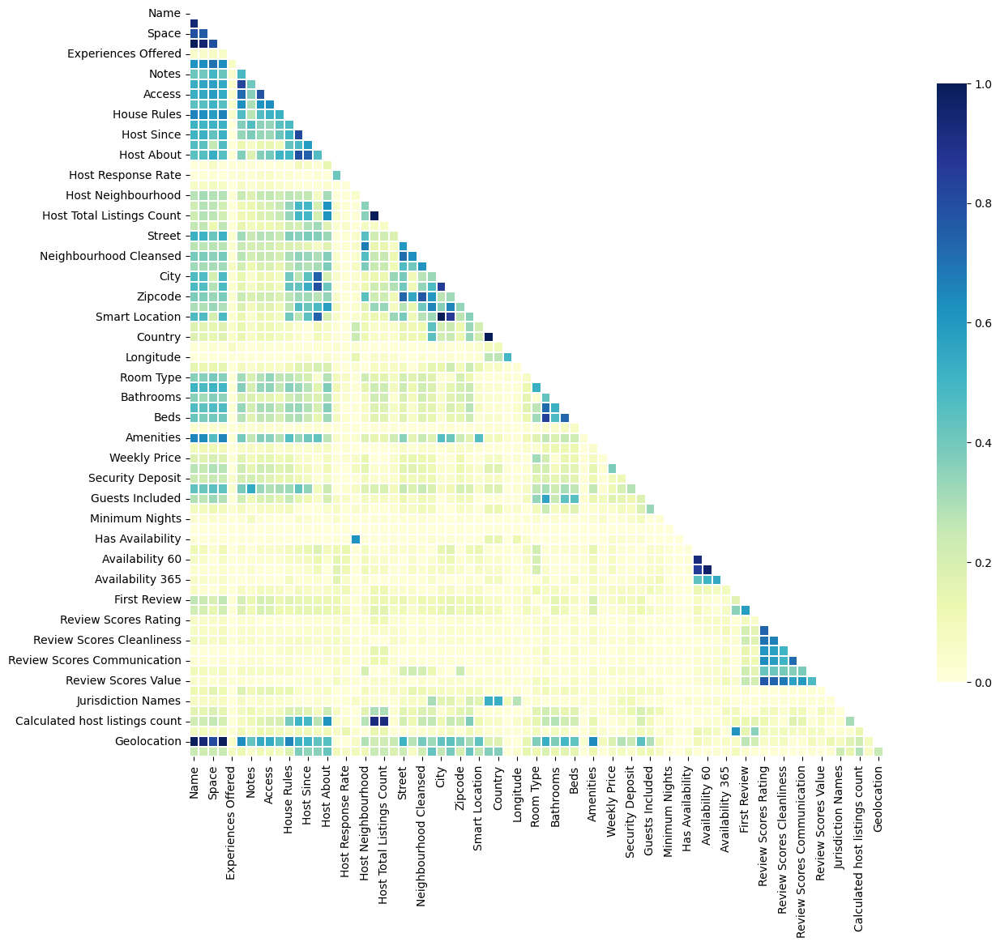

In [16]:
import seaborn as sns
corr = np.abs(house_data_encoded.drop(['Price'], axis=1).corr())

mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(14, 12))

sns.heatmap(corr, mask=mask,vmin = 0.0, vmax=1.0, center=0.5,
            linewidths=.3, cmap="YlGnBu", cbar_kws={"shrink": .8})

plt.show()

Viendo la correlación que hay entre las columnas decidimos eliminar Calculated host listing count ya que
depende de Host Total Listings Count. Eliminamos también Has Availability ya que si tiene Availability 365 
tiene también Availability. Además como dejamos el Zip code y la longitud y latitud podemos quitar 
Smart Location y Country Code ya que se vuelven innecesarios, además quitamos Notes y Access ya que vienen
incluidas probablemente en las notas de la casa.

In [17]:
listaDROP2 = [
    'Calculated host listings count', 'Has Availability', 'Smart Location', 'Notes', 'Access', 'Country Code']

house_data_encoded = house_data_encoded.drop(listaDROP2, axis=1)

Pintamos la correlación otra vez a ver si ha cambiado algo.

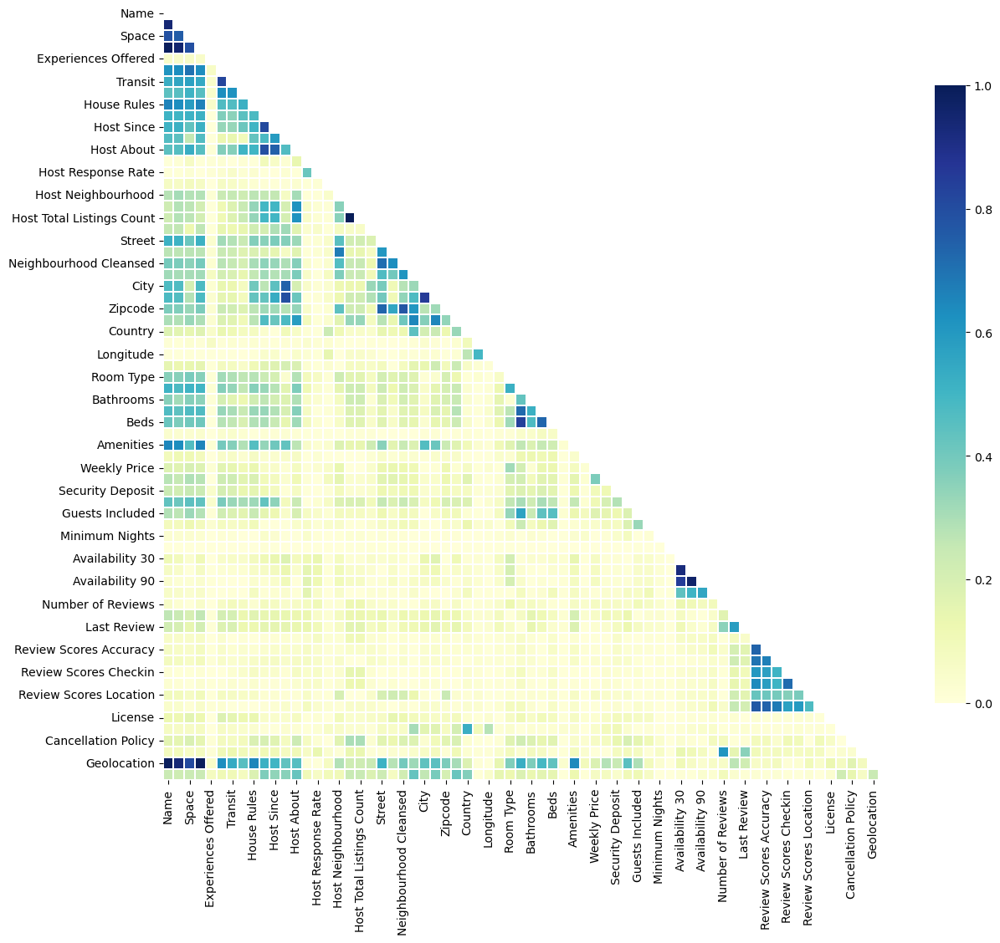

In [18]:
import seaborn as sns
corr = np.abs(house_data_encoded.drop(['Price'], axis=1).corr())

mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(14, 12))

sns.heatmap(corr, mask=mask,vmin = 0.0, vmax=1.0, center=0.5,
            linewidths=.3, cmap="YlGnBu", cbar_kws={"shrink": .8})

plt.show()

Nos quedamos con lo que tenemos ya que no vemos más correlaciones fuertes.

## 3. Visualización (y más análisis)

In [19]:
# Mostramos estadísticas descriptivas
# Separamos las columnas numéricas para luego decir como rellenaremos sus nulos
numerical_cols = house_data.select_dtypes(include=['number']).columns.tolist()

# Detectamos outliers en las columnas numéricas con más de 10 valores únicos
columns_with_outliers, columns_without_outliers = detect_outliers(house_data, numerical_cols)

print("Columnas con outliers:", columns_with_outliers)

Columnas con outliers: ['Scrape ID', 'Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Latitude', 'Longitude', 'Accommodates', 'Bathrooms', 'Bedrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Guests Included', 'Extra People', 'Minimum Nights', 'Maximum Nights', 'Number of Reviews', 'Review Scores Rating', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value', 'Calculated host listings count', 'Reviews per Month']


In [20]:
numerical_columns2 = [col for col in columns_with_outliers if col not in categorical_cols]

listaDROP3 = listaDROP + listaDROP2
# Filtramos la lista categorical_columns2 eliminando los elementos de listaDROP3
numerical_columns2_filtradas = [col for col in numerical_columns2 if col not in listaDROP3]

print(numerical_columns2_filtradas)

['Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Latitude', 'Longitude', 'Accommodates', 'Bathrooms', 'Bedrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Guests Included', 'Extra People', 'Minimum Nights', 'Maximum Nights', 'Number of Reviews', 'Review Scores Rating', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value', 'Reviews per Month']


Visualizamos las variables numéricas para poder realizar un análisis sobre sus outliers y si tienen sentido.

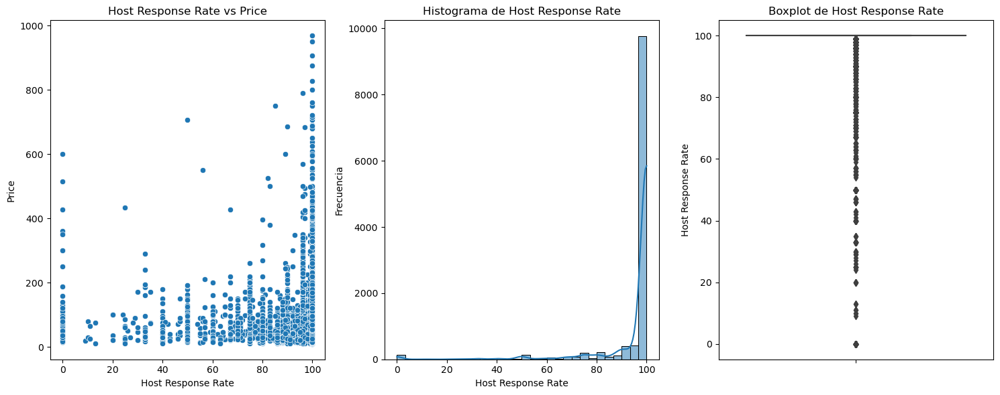

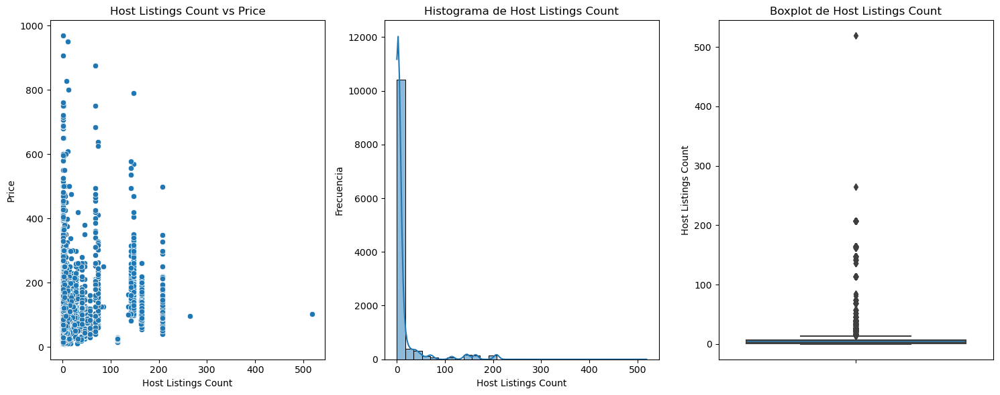

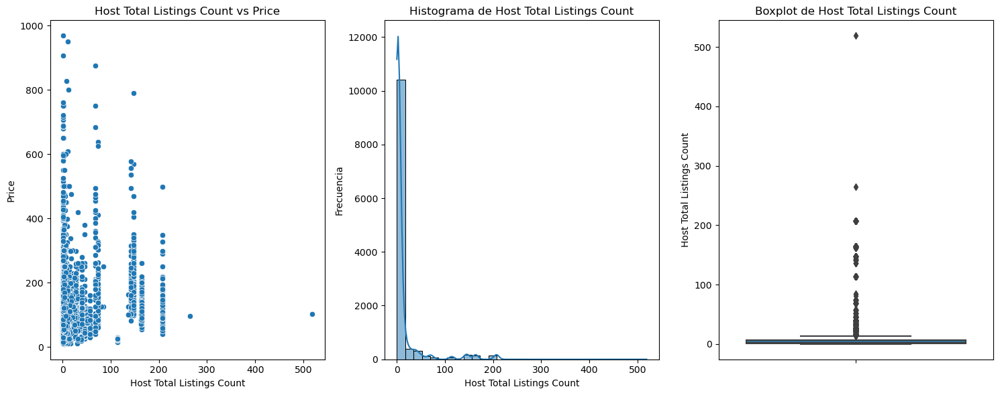

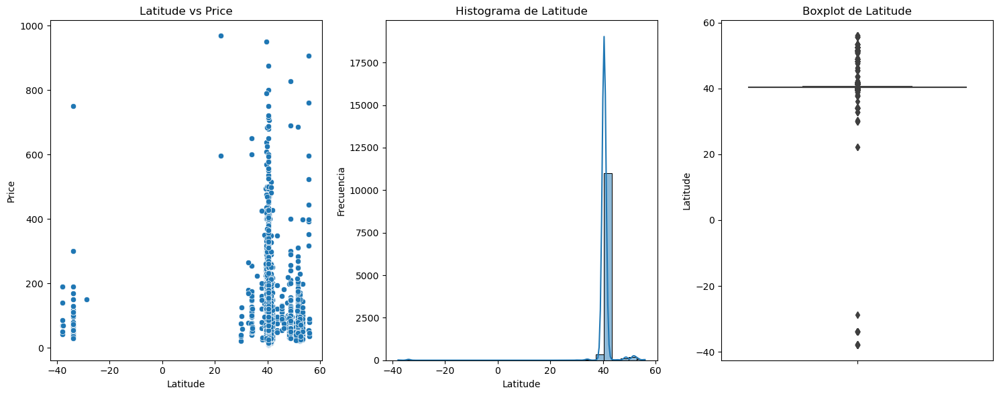

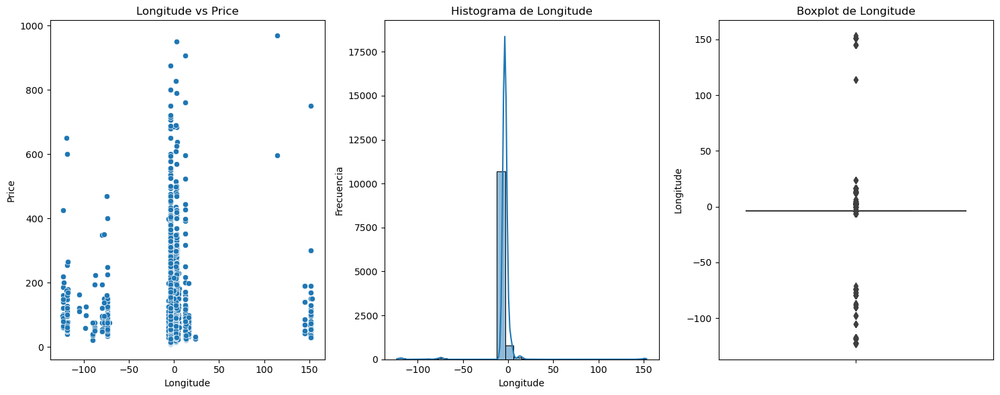

...

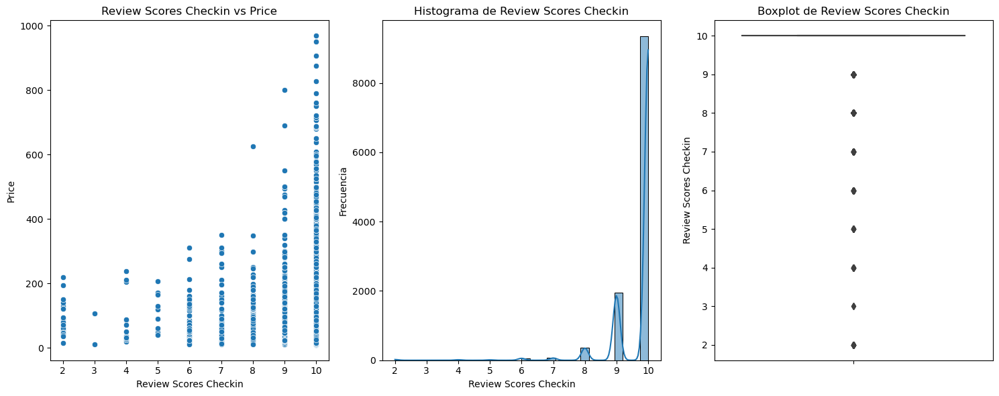

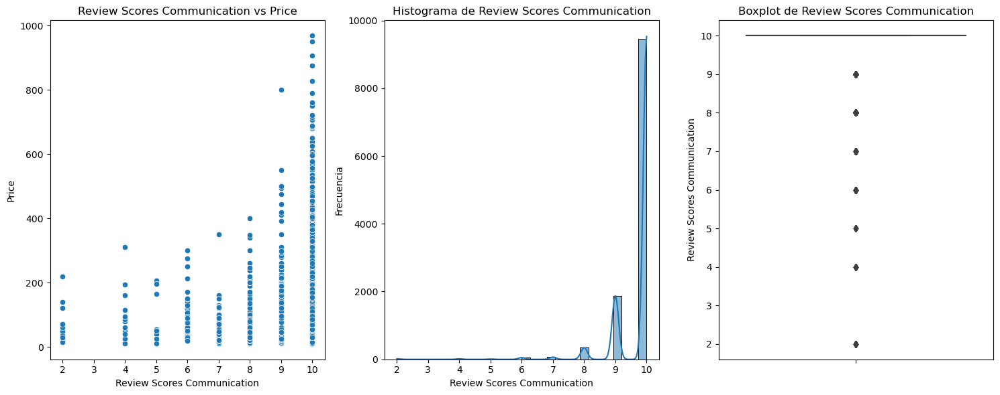

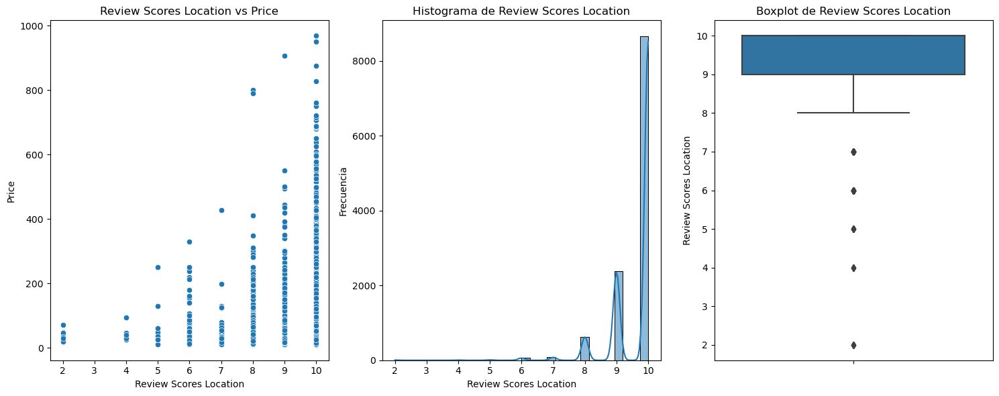

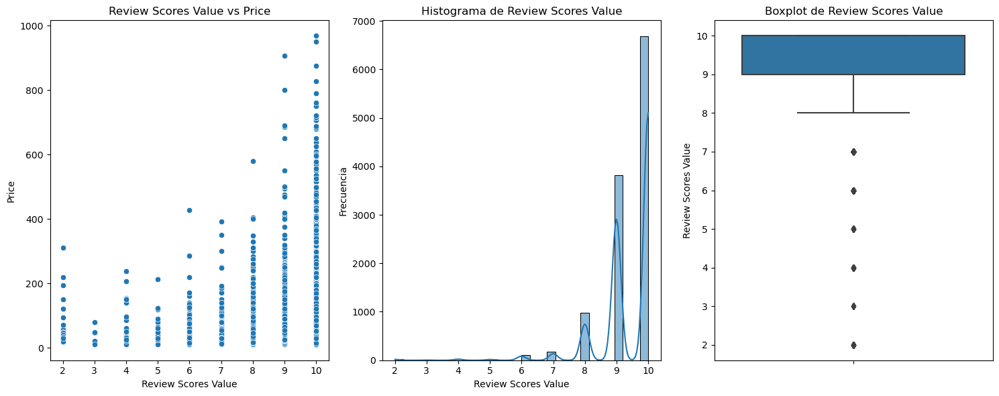

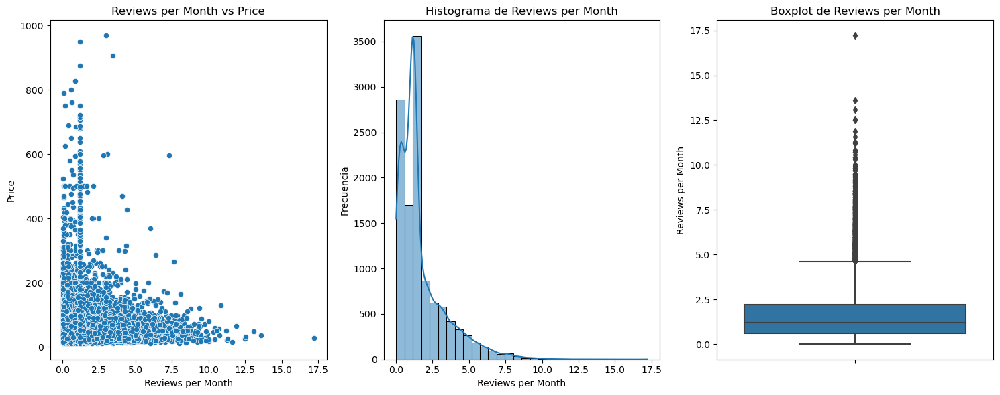

In [21]:
for k in numerical_columns2_filtradas:
    plt.figure(figsize=(15, 6))
    
    # Scatter plot con Price
    plt.subplot(1, 3, 1)
    sns.scatterplot(x=house_data_encoded[k], y=house_data_encoded['Price'])
    plt.title(k + ' vs Price')
    plt.xlabel(k)
    plt.ylabel('Price')
    
    # Histograma
    plt.subplot(1, 3, 2)
    sns.histplot(house_data_encoded[k], bins=30, kde=True)
    plt.title('Histograma de ' + k)
    plt.xlabel(k)
    plt.ylabel('Frecuencia')

    # Boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=house_data_encoded[k])
    plt.title('Boxplot de ' + k)

    plt.tight_layout()
    plt.show()

Revisamos los datos de las siguientes columnas para ayudarnos a pensar las condiciones de filtrado si fueran necesarias.

In [22]:
for k in ['Bedrooms', 'Square Feet', 'Extra People', 'Minimum Nights', 'Maximum Nights', 'Host Acceptance Rate']:
    print(house_data_encoded[k].value_counts())

Bedrooms
1.0     7821
2.0     2089
0.0      814
3.0      734
4.0      241
5.0       74
6.0       29
7.0        9
8.0        7
10.0       6
Name: count, dtype: int64
Square Feet
90.0      11353
0.0         196
484.0        14
646.0        12
1076.0       11
700.0        11
807.0        10
861.0        10
753.0        10
431.0         9
538.0         8
969.0         8
108.0         7
323.0         7
377.0         6
215.0         6
55.0          6
129.0         6
1292.0        6
592.0         5
2153.0        5
269.0         5
40.0          5
1184.0        4
2691.0        4
100.0         3
25.0          3
603.0         3
1615.0        3
50.0          3
409.0         3
75.0          3
151.0         3
398.0         3
86.0          3
291.0         2
70.0          2
570.0         2
1507.0        2
35.0          2
194.0         2
1044.0        2
150.0         2
280.0         2
452.0         2
8.0           2
30.0          2
344.0         2
1130.0        2
624.0         2
161.0         2
2282.0 

In [23]:
# Filtramos el dataframe sin los outliers haciendo uno nuevo.

conditions = (
    (house_data_encoded['Minimum Nights'] <= 60 ) &
    (house_data_encoded['Host Acceptance Rate'] <= 100) &
    (house_data_encoded['Square Feet'] > 0) )

house_data_encoded_sin_outliers = house_data_encoded[conditions]

print(f"Tamaño del dataframe original: {house_data_encoded.shape}")
print(f"Tamaño del dataframe sin outliers: {house_data_encoded_sin_outliers.shape}")

Tamaño del dataframe original: (11824, 69)
Tamaño del dataframe sin outliers: (11587, 69)


Así nos queda el data frame una vez aplicacadas las normas elegidas en el código anterior.

In [24]:
house_data_encoded_sin_outliers.describe()

,Name,Summary,Space,Description,Experiences Offered,Neighborhood Overview,Transit,Interaction,House Rules,Host Name,Host Since,Host Location,Host About,Host Response Time,Host Response Rate,Host Acceptance Rate,Host Neighbourhood,Host Listings Count,Host Total Listings Count,Host Verifications,Street,Neighbourhood,Neighbourhood Cleansed,Neighbourhood Group Cleansed,City,State,Zipcode,Market,Country,Latitude,Longitude,Property Type,Room Type,Accommodates,Bathrooms,Bedrooms,Beds,Bed Type,Amenities,Square Feet,Price,Weekly Price,Monthly Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Availability 30,Availability 60,Availability 90,Availability 365,Number of Reviews,First Review,Last Review,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,License,Jurisdiction Names,Cancellation Policy,Reviews per Month,Geolocation,Features
count,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.00000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000,11587.000000
mean,73.665645,74.091754,72.595362,73.643496,73.602974,75.194699,76.556859,76.361331,73.379018,74.769043,76.803692,72.829123,75.202333,73.686165,95.429792,73.505110,72.394352,12.684560,12.684560,73.688473,69.760745,72.298264,71.187867,73.425911,70.612319,72.631880,69.756909,72.855199,73.240060,40.496344,-3.707469,73.548559,73.607391,3.267282,1.283248,1.340813,2.040304,73.703380,75.128471,103.917839,73.445240,356.472599,1253.452835,166.649607,29.106240,1.577199,7.575386,2.729007,966.373004,8.927160,22.912920,39.754466,201.205230,21.935359,75.314820,73.244790,92.160007,9.547338,9.475964,9.71071,9.728316,9.641322,9.393286,73.157294,73.443221,73.506395,1.733746,73.657157,73.118783
std,9.505556,9.928174,8.089727,9.603353,0.729921,7.652518,8.402561,11.001285,10.341947,23.867659,26.382976,28.134228,21.487327,0.864304,14.398863,0.138157,16.353582,34.566235,34.566235,16.063126,16.892879,14.785187,20.321503,22.629221,23.991294,28.760093,18.190012,19.329843,8.070466,4.687081,13.501447,9.147393,26.631128,2.090504,0.661634,0.902895,1.615408,2.516989,16.229114,147.507003,71.118824,95.871886,598.546349,77.884134,24.181467,1.157153,12.328201,3.574309,9482.831529,9.324216,19.750872,29.676279,128.283615,36.792996,8.423094,10.507436,8.117169,0.857778,0.927925,0.72264,0.690290,0.705294,0.907836,1.289062,3.751700,11.274335,1.681429,9.253162,15.481523
min,62.894264,48.531043,48.531043,48.531043,68.845514,35.365164,45.118610,36.401348,46.350022,22.751262,24.915187,38.352998,22.751262,72.130060,0.000000,67.065990,35.086364,0.000000,0.000000,41.071173,37.070334,34.824179,30.614962,34.334459,61.271335,61.271335,32.591871,62.002959,62.002959,-37.851182,-123.124429,39.558394,31.321016,1.000000,0.000000,0.000000,1.000000,48.340056,42.703434,8.000000,9.000000,70.000000,250.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.964456,49.546958,20.000000,2.000000,2.000000,2.00000,2.000000,2.000000,2.000000,66.703478,68.449699,64.179446,0.020000,65.272285,53.230758
25%,68.394889,68.524997,69.538957,68.394889,73.583065,70.346516,70.086299,70.606733,

## 4. Generación de nuevas características

Generamos la variable metros cuadrados junto con la variable precio por metros cuadrados a ver si nos resultan útiles en el modelo.

In [25]:
house_data_encoded_sin_outliers['m2'] = house_data_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048

#house_data_encoded_sin_outliers['m2'] = house_data_encoded_sin_outliers['Square Feet'].apply(sqft_to_m2)

C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\4062520107.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_encoded_sin_outliers['m2'] = house_data_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048


In [26]:
house_data_encoded_sin_outliers['Price_Agains_m2'] = house_data_encoded_sin_outliers['Price']/house_data_encoded_sin_outliers['m2']
house_data_encoded_sin_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11587 entries, 0 to 11823
Data columns (total 71 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Name                          11587 non-null  float64
 1   Summary                       11587 non-null  float64
 2   Space                         11587 non-null  float64
 3   Description                   11587 non-null  float64
 4   Experiences Offered           11587 non-null  float64
 5   Neighborhood Overview         11587 non-null  float64
 6   Transit                       11587 non-null  float64
 7   Interaction                   11587 non-null  float64
 8   House Rules                   11587 non-null  float64
 9   Host Name                     11587 non-null  float64
 10  Host Since                    11587 non-null  float64
 11  Host Location                 11587 non-null  float64
 12  Host About                    11587 non-null  float64
 13  Host R

C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\1371795214.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_encoded_sin_outliers['Price_Agains_m2'] = house_data_encoded_sin_outliers['Price']/house_data_encoded_sin_outliers['m2']


## 5. Modelado, cross-validation y estudio de resultados en train y test

Combinamos todo nuestro preprocesamiento en una única celda:

In [27]:
from category_encoders import TargetEncoder
import pandas as pd
from sklearn.preprocessing import LabelEncoder


# Carga de datos
house_data = pd.read_csv('./data/airbnb-listings-extract_train.csv', sep=';', decimal='.')

# Imputación
# Iteramos sobre cada columna en la lista y rellenamos los nulos con la mediana
for column in ['Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Bathrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Review Scores Rating', 'Calculated host listings count', 'Reviews per Month']:
    house_data[column].fillna(house_data[column].median(), inplace=True) 

# Iteramos sobre cada columna en la lista y rellenamos los nulos con la moda
for column in ['Bedrooms', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value']:
    house_data[column].fillna(house_data[column].mode()[0], inplace=True)
    
# Imputación variables catergóricas
categorical_cols_nulls = ['Summary', 'Space', 'Neighborhood Overview', 'Notes', 'Transit', 'Access', 'Interaction', 'House Rules', 'Host Location', 'Host About', 'Host Response Time', 'Host Acceptance Rate', 'Host Neighbourhood', 'Host Verifications', 'Neighbourhood', 'Neighbourhood Group Cleansed', 'City', 'State', 'Zipcode', 'Market', 'Amenities', 'Has Availability', 'First Review', 'Last Review', 'License', 'Jurisdiction Names', 'Last Scraped', 'Name', 'Description', 'Experiences Offered', 'Host Name', 'Host Since', 'Street', 'Neighbourhood Cleansed', 'Smart Location', 'Country Code', 'Country', 'Property Type', 'Room Type', 'Bed Type', 'Calendar Updated', 'Calendar last Scraped', 'Cancellation Policy', 'Geolocation', 'Features', 'Host Response Rate', 'Bathrooms', 'Bedrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Review Scores Rating', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value', 'Reviews per Month']

# Sustituimos nulos por 'Desconocido'
house_data[categorical_cols_nulls] = house_data[categorical_cols_nulls].fillna('Desconocido')

# Especificamos la variable objetivo
variable_objetivo = 'Price'  

# Aplicamos TargetEncoder
encoder = TargetEncoder(cols=categorical_cols_nulls)
house_data_encoded = encoder.fit_transform(house_data, house_data[variable_objetivo])

# Guardamos los datos codificados
house_data_encoded.to_csv('./data/archivo_codificado_train.csv', index=False)
   
# Eliminamos las columnas sin interés 
listaDROP2 = ['Calculated host listings count', 'Has Availability', 'Smart Location', 'Notes', 'Access', 'Country Code']
listaDROP = ['ID', 'Scrape ID', 'Host ID', 'Last Scraped', 'Calendar Updated', 'Calendar last Scraped']
listaDROP3 = listaDROP + listaDROP2

house_data_encoded=house_data_encoded.drop(columns=listaDROP3)

# Filtramos el dataframe sin los outliers haciendo uno nuevo.

conditions = (
    (house_data_encoded['Minimum Nights'] <= 60 ) &
    (house_data_encoded['Host Acceptance Rate'] <= 100) &
    (house_data_encoded['Square Feet'] > 0) )

house_data_encoded_sin_outliers = house_data_encoded[conditions]


# Generamos características
# Añadimos variable metro cuadrado
house_data_encoded_sin_outliers['m2'] = house_data_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048
# Añadimos variable de precio por metro cuadrado
house_data_encoded_sin_outliers['Price_Agains_m2'] = house_data_encoded_sin_outliers['Price']/house_data_encoded_sin_outliers['m2']
house_data_encoded_sin_outliers.info

C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\1970293050.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_encoded_sin_outliers['m2'] = house_data_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048
C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\1970293050.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_encoded_sin_outliers['Price_Agains_m2'] = house_data_encoded_sin_outliers['Price']/house_data_encoded_sin_outliers['m2']


<bound method DataFrame.info of              Name     Summary       Space  Description  Experiences Offered  \
0       71.907817   71.907817   71.907817    71.907817            73.583065   
1       70.606733   70.606733   70.606733    70.606733            73.583065   
2       65.402394   65.402394   69.538957    65.402394            73.583065   
3       68.004563   68.004563   69.538957    68.004563            73.583065   
4       68.264780   84.031983   68.264780    68.264780            73.583065   
5       68.655106   68.655106   68.655106    68.655106            73.583065   
6       74.509987   74.509987   74.509987    74.509987            73.583065   
7       67.354021   65.910674   65.300044    65.910674            73.583065   
8       73.078794   73.078794   73.078794    73.078794            73.583065   
9       84.658448   84.658448   84.658448    84.658448            73.583065   
10      66.995064   67.874455   69.538957    67.874455            73.583065   
11      75.160529   

Y ahora aplicamos fácilmente a test:

In [28]:
# Carga de datos
house_data_test = pd.read_csv('./data/airbnb-listings-extract_test.csv', sep=';', decimal='.')

# Imputación
# Iteramos sobre cada columna en la lista y rellenamos los nulos con la mediana
for column in ['Host Response Rate', 'Host Listings Count', 'Host Total Listings Count', 'Bathrooms', 'Beds', 'Square Feet', 'Price', 'Weekly Price', 'Monthly Price', 'Security Deposit', 'Cleaning Fee', 'Review Scores Rating', 'Calculated host listings count', 'Reviews per Month']:
    house_data_test[column].fillna(house_data[column].median(), inplace=True) 

# Iteramos sobre cada columna en la lista y rellenamos los nulos con la moda
for column in ['Bedrooms', 'Review Scores Accuracy', 'Review Scores Cleanliness', 'Review Scores Checkin', 'Review Scores Communication', 'Review Scores Location', 'Review Scores Value']:
    house_data_test[column].fillna(house_data[column].mode()[0], inplace=True)

# Imputación variables catergóricas
categorical_cols_nulls = ['Summary', 'Space', 'Neighborhood Overview', 'Notes', 'Transit', 'Access', 'Interaction', 'House Rules', 'Host Location', 'Host About', 'Host Response Time', 'Host Acceptance Rate', 'Host Neighbourhood', 'Host Verifications', 'Neighbourhood', 'Neighbourhood Group Cleansed', 'City', 'State', 'Zipcode', 'Market', 'Amenities', 'Has Availability', 'First Review', 'Last Review', 'License', 'Jurisdiction Names']
# Sustituir nulos por 'Desconocido'
house_data_test[categorical_cols_nulls] = house_data[categorical_cols_nulls].fillna('Desconocido') 

# Aplicamos el encoder al conjunto de datos de prueba
house_data_test_encoded = encoder.transform(house_data_test)

# Guardamos los datos codificados
house_data_test_encoded.to_csv('./data/archivo_codificado_test.csv', index=False)
   
# Eliminamos las columnas sin interés 
listaDROP2 = ['Calculated host listings count', 'Has Availability', 'Smart Location', 'Notes', 'Access', 'Country Code']
listaDROP = ['ID', 'Scrape ID', 'Host ID', 'Last Scraped', 'Calendar Updated', 'Calendar last Scraped']
listaDROP3 = listaDROP + listaDROP2

house_data_test_encoded=house_data_test_encoded.drop(columns=listaDROP3)

# Filtramos el dataframe sin los outliers haciendo uno nuevo.

conditions = (
    (house_data_test_encoded['Minimum Nights'] <= 60 ) &
    (house_data_test_encoded['Host Acceptance Rate'] <= 100) &
    (house_data_test_encoded['Square Feet'] > 0) )

house_data_test_encoded_sin_outliers = house_data_test_encoded[conditions]


# Generamos características
# Añadimos variable metro cuadrado
house_data_test_encoded_sin_outliers['m2'] = house_data_test_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048
# Añadimos variable de precio por metro cuadrado
house_data_test_encoded_sin_outliers['Price_Agains_m2'] = house_data_test_encoded_sin_outliers['Price']/house_data_test_encoded_sin_outliers['m2']
pd.set_option('display.max_rows', None)

C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\2234225955.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_test_encoded_sin_outliers['m2'] = house_data_test_encoded_sin_outliers['Square Feet'] * 0.3048 * 0.3048
C:\Users\alzua\AppData\Local\Temp\ipykernel_16740\2234225955.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  house_data_test_encoded_sin_outliers['Price_Agains_m2'] = house_data_test_encoded_sin_outliers['Price']/house_data_test_encoded_sin_outliers['m2']


Ahora podemos preparar los datos para sklearn:

In [29]:
from sklearn import preprocessing

# Dataset de train
data_train = house_data_encoded_sin_outliers.values
y_train = data_train[:,40:41]     # nos quedamos con la columna, price
X_train = np.delete(data_train, 40, axis=1)     # nos quedamos con el resto

# Dataset de test
data_test = house_data_test_encoded_sin_outliers.values
y_test = data_test[:,40:41]   # nos quedamos con la columna, price
X_test = np.delete(data_test, 40, axis=1)     # nos quedamos con el resto

Y si queremos, podemos normalizar, pero con los datos de train!

In [30]:
# Escalamos (con los datos de train)
scaler = preprocessing.StandardScaler().fit(X_train)
XtrainScaled = scaler.transform(X_train)

# recordad que esta normalización/escalado la realizo con el scaler anterior, basado en los datos de training!
XtestScaled = scaler.transform(X_test) 


In [31]:
print('Datos entrenamiento: ', XtrainScaled.shape)
print('Datos test: ', XtestScaled.shape)

Datos entrenamiento:  (11783, 70)
Datos test:  (2945, 70)


Buscámos el alpha óptimo.

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[CV] END .......................................alpha=0.0001; total time=   5.5s
[CV] END .......................................alpha=0.0001; total time=   5.2s
[CV] END .......................................alpha=0.0001; total time=   6.0s
[CV] END .......................................alpha=0.0001; total time=   7.2s
[CV] END .......................................alpha=0.0001; total time=   6.1s
[CV] END .......................alpha=0.00014563484775012445; total time=   5.2s
[CV] END .......................alpha=0.00014563484775012445; total time= 2.4min
[CV] END .......................alpha=0.00014563484775012445; total time=   2.0s
[CV] END .......................alpha=0.00014563484775012445; total time=   3.6s
[CV] END .......................alpha=0.00014563484775012445; total time=   6.0s
[CV] END .......................alpha=0.00021209508879201905; total time=   4.7s
[CV] END .......................alpha=0.0002120

[CV] END ..........................alpha=0.18420699693267145; total time=   0.2s
[CV] END ..........................alpha=0.18420699693267145; total time=   0.2s
[CV] END ..........................alpha=0.18420699693267145; total time=   0.2s
[CV] END ..........................alpha=0.18420699693267145; total time=   0.2s
[CV] END ...........................alpha=0.2682695795279725; total time=   0.1s
[CV] END ...........................alpha=0.2682695795279725; total time=   0.1s
[CV] END ...........................alpha=0.2682695795279725; total time=   0.1s
[CV] END ...........................alpha=0.2682695795279725; total time=   0.1s
[CV] END ...........................alpha=0.2682695795279725; total time=   0.1s
[CV] END ...........................alpha=0.3906939937054613; total time=   0.1s
[CV] END ...........................alpha=0.3906939937054613; total time=   0.1s
[CV] END ...........................alpha=0.3906939937054613; total time=   0.1s
[CV] END ...................

[CV] END ............................alpha=494.1713361323828; total time=   0.0s
[CV] END ............................alpha=494.1713361323828; total time=   0.0s
[CV] END ............................alpha=719.6856730011514; total time=   0.0s
[CV] END ............................alpha=719.6856730011514; total time=   0.0s
[CV] END ............................alpha=719.6856730011514; total time=   0.0s
[CV] END ............................alpha=719.6856730011514; total time=   0.0s
[CV] END ............................alpha=719.6856730011514; total time=   0.0s
[CV] END ...........................alpha=1048.1131341546852; total time=   0.0s
[CV] END ...........................alpha=1048.1131341546852; total time=   0.0s
[CV] END ...........................alpha=1048.1131341546852; total time=   0.0s
[CV] END ...........................alpha=1048.1131341546852; total time=   0.0s
[CV] END ...........................alpha=1048.1131341546852; total time=   0.0s
[CV] END ...................

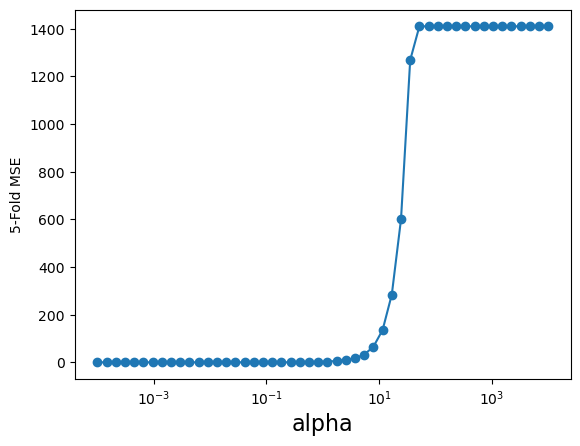

In [32]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso

alpha_vector = np.logspace(-4,4,50)
param_grid = {'alpha': alpha_vector }
grid = GridSearchCV(Lasso(), scoring= 'neg_mean_squared_error', param_grid=param_grid, cv = 5, verbose=2)
grid.fit(XtrainScaled, y_train)
print("best mean cross-validation score: {:.5f}".format(grid.best_score_))
print("best parameters: {}".format(grid.best_params_))

#-1 porque es negado
scores = -1*np.array(grid.cv_results_['mean_test_score'])
plt.semilogx(alpha_vector,scores,'-o')
plt.xlabel('alpha',fontsize=16)
plt.ylabel('5-Fold MSE')
plt.show()

In [33]:
from sklearn.metrics import mean_squared_error

alpha_optimo = grid.best_params_['alpha']
lasso = Lasso(alpha = alpha_optimo).fit(XtrainScaled,y_train)

ytrainLasso = lasso.predict(XtrainScaled)
ytestLasso  = lasso.predict(XtestScaled)
mseTrainModelLasso = mean_squared_error(y_train,ytrainLasso)
mseTestModelLasso = mean_squared_error(y_test,ytestLasso)

print('MSE Modelo Lasso (train): %0.3g' % mseTrainModelLasso)
print('MSE Modelo Lasso (test) : %0.3g' % mseTestModelLasso)

print('RMSE Modelo Lasso (train): %0.3g' % np.sqrt(mseTrainModelLasso))
print('RMSE Modelo Lasso (test) : %0.3g' % np.sqrt(mseTestModelLasso))

feature_names = house_data.columns[1:] # es igual en train y en test

w = lasso.coef_
for f,wi in zip(feature_names,w):
    print(f,wi)

MSE Modelo Lasso (train): 0.468
MSE Modelo Lasso (test) : 0.339
RMSE Modelo Lasso (train): 0.684
RMSE Modelo Lasso (test) : 0.583
Scrape ID 0.028956540898439617
Last Scraped -0.05613425121212925
Name 0.054216577095454875
Summary -0.024538462937335803
Space -0.004171171557961305
Description 0.007240482432499362
Experiences Offered 0.03114148580050727
Neighborhood Overview -0.07805912739232496
Notes 0.041753010704985424
Transit 0.0
Access -0.0
Interaction -0.026739398225841562
House Rules 0.08014059357575168
Host ID -0.0
Host Name -0.012521713216673176
Host Since 0.0
Host Location -0.0015811067180884516
Host About -0.024487104377565697
Host Response Time -0.0
Host Response Rate -0.0019120756124741355
Host Acceptance Rate -0.0050703226795718636
Host Neighbourhood 0.0
Host Listings Count -0.0
Host Total Listings Count 0.0
Host Verifications -0.0
Street 0.0
Neighbourhood -0.015752977789330398
Neighbourhood Cleansed -0.02576022942591356
Neighbourhood Group Cleansed -0.0
City -0.0
State -0.00

### Análisis de Resultados del Modelo Lasso

En nuestra reciente iteración del modelo Lasso, hemos observado mejoras significativas en las métricas de error:

- **MSE (train):** 0.468
- **MSE (test):** 0.339
- **RMSE (train):** 0.684
- **RMSE (test):** 0.583

Estos resultados indican que nuestro modelo se ajusta bien a los datos de entrenamiento y generaliza adecuadamente en el conjunto de prueba.

### Coeficientes del Modelo

Características relevantes:
- **Room Type:** 1.5896
- **Review Scores Checkin:** 37.3923
- **Review Scores Cleanliness:** 0.1056
- **House Rules:** 0.0801

### Interpretación de Resultados

1. **Exactitud y Generalización:** Las bajas diferencias entre las métricas de entrenamiento y prueba muestran un buen equilibrio, evitando el sobreajuste.
2. **Importancia de Características:** `Room Type` y `Review Scores Checkin` son factores clave en las predicciones, destacando su relevancia.
3. **Características Irrelevantes:** Muchas características tienen coeficientes cercanos a cero y pueden ser excluidas en futuras iteraciones para simplificar el modelo.

En resumen, nuestro modelo Lasso ha mostrado un rendimiento robusto con mejoras significativas en las métricas de error, identificando características clave que pueden guiar futuras mejoras.


## Random Forest

In [34]:
from sklearn.ensemble import RandomForestRegressor
import numpy as np

# Convertir y_train y y_test a arrays unidimensionales si son DataFrames
y_train = np.ravel(y_train)
y_test = np.ravel(y_test)

rf = RandomForestRegressor()
param_grid = {
    'n_estimators': [10, 100],
    'max_features': ['auto', 'sqrt'],
    'max_depth': [10, 20],
}
rf_cv = GridSearchCV(rf, param_grid, cv=10, scoring='neg_mean_squared_error',verbose=2)
rf_cv.fit(XtrainScaled, y_train)

# Mejor modelo y métricas
best_rf = rf_cv.best_estimator_
y_train_pred = best_rf.predict(XtrainScaled)
y_test_pred = best_rf.predict(XtestScaled)

mse_train_rf = mean_squared_error(y_train, y_train_pred)
mse_test_rf = mean_squared_error(y_test, y_test_pred)
rmse_train_rf = mse_train_rf**0.5
rmse_test_rf = mse_test_rf**0.5

print(f'MSE Random Forest (train): {mse_train_rf}')
print(f'MSE Random Forest (test) : {mse_test_rf}')
print(f'RMSE Random Forest (train): {rmse_train_rf}')
print(f'RMSE Random Forest (test) : {rmse_test_rf}')


Fitting 10 folds for each of 8 candidates, totalling 80 fits
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ...max_depth=10, max_features=auto, n_estimators=10; total time=   0.0s
[CV] END ..max_depth=10, max_features=auto, n_estimators=100; total time=   0.0s
[CV] END ..max_depth=10, max_features=auto, n_es

C:\Users\alzua\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
40 fits failed out of a total of 80.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\alzua\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 732, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\alzua\anaconda3\Lib\site-packages\sklearn\base.py", line 1144, in wrapper
    estimator._validate_params()
  File "C:\Users\alzua\anaconda3\Lib\site-packages\sklearn\base.py", line 637, in _validate_params
    validate_parameter_constraints(
  File "C:\Users\alzua\anaconda3\Lib\site-packages\

MSE Random Forest (train): 2.3870701389362394
MSE Random Forest (test) : 1015.2906844480997
RMSE Random Forest (train): 1.545014608000921
RMSE Random Forest (test) : 31.86362635432602


Estas métricas indican que el modelo Random Forest ha logrado ajustar bastante bien los datos de entrenamiento, con un error relativamente bajo. Las métricas de error en el conjunto de prueba son significativamente más altas que en el conjunto de entrenamiento. Esto sugiere que el modelo podría estar sobreajustado (overfitting) a los datos de entrenamiento. El sobreajuste ocurre cuando un modelo se ajusta demasiado bien a los datos de entrenamiento y no generaliza bien en datos no vistos. Además nos sale un warning, vamos a intentar solucionar estos problemas ajustando los parámetros.

In [35]:
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

# Asegúrate de que y_train y y_test sean arrays unidimensionales
y_train = np.ravel(y_train)
y_test = np.ravel(y_test)

# Verificar valores NaN e infinitos en los datos
print("Valores NaN en X_train:", np.isnan(XtrainScaled).sum())
print("Valores NaN en y_train:", np.isnan(y_train).sum())
print("Valores infinitos en X_train:", np.isinf(XtrainScaled).sum())
print("Valores infinitos en y_train:", np.isinf(y_train).sum())

# Definir el modelo y el grid de hiperparámetros
rf = RandomForestRegressor()
param_grid = {
    'n_estimators': [10, 50, 100],
    'max_features': ['sqrt', 'log2'],
    'max_depth': [5, 10],
    'min_samples_split': [10, 20],
    'min_samples_leaf': [4, 6]
}

# Configurar Grid Search con validación cruzada
rf_cv = GridSearchCV(rf, param_grid, cv=10, scoring='neg_mean_squared_error', return_train_score=True)
rf_cv.fit(X_train, y_train)

# Verificar si GridSearchCV se ajustó correctamente
print(f'Mejores parámetros encontrados: {rf_cv.best_params_}')
print(f'Mejor puntuación (neg_mean_squared_error): {rf_cv.best_score_}')

# Obtener el mejor modelo
best_rf = rf_cv.best_estimator_

# Predicciones
y_train_pred = best_rf.predict(X_train)
y_test_pred = best_rf.predict(X_test)

# Calcular y mostrar las métricas de error
mse_train_rf = mean_squared_error(y_train, y_train_pred)
mse_test_rf = mean_squared_error(y_test, y_test_pred)
rmse_train_rf = mse_train_rf**0.5
rmse_test_rf = mse_test_rf**0.5

print(f'MSE Random Forest (train): {mse_train_rf}')
print(f'MSE Random Forest (test) : {mse_test_rf}')
print(f'RMSE Random Forest (train): {rmse_train_rf}')
print(f'RMSE Random Forest (test) : {rmse_test_rf}')


Valores NaN en X_train: 0
Valores NaN en y_train: 0
Valores infinitos en X_train: 0
Valores infinitos en y_train: 0
Mejores parámetros encontrados: {'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 100}
Mejor puntuación (neg_mean_squared_error): -29.16862446118908
MSE Random Forest (train): 14.715920762821215
MSE Random Forest (test) : 1071.0502051901365
RMSE Random Forest (train): 3.8361335694708565
RMSE Random Forest (test) : 32.72690338529046


## Conclusiones

### Error en train

El modelo de Lasso presenta un MSE y RMSE mucho más bajos en el conjunto de entrenamiento en comparación con el modelo de Random Forest, lo que indica que Lasso ha ajustado los datos de entrenamiento de manera más precisa.
Random Forest muestra un error considerablemente mayor en el conjunto de entrenamiento. Esto sugiere que el modelo ha ajustado los datos de entrenamiento con menos precisión en términos absolutos, pero hay que considerar que Random Forest tiende a tener una mayor varianza debido a su naturaleza más compleja.

### Error en Prueba

Para el conjunto de prueba, Lasso también presenta errores (MSE y RMSE) mucho más bajos en comparación con Random Forest. Esto indica que Lasso está generalizando mejor a datos no vistos.
Random Forest tiene un MSE y RMSE extremadamente altos en el conjunto de prueba, lo que indica un problema significativo de sobreajuste. A pesar de su mejor rendimiento en el entrenamiento (en términos de RMSE), falla en generalizar correctamente, lo que sugiere que el modelo está sobreajustado a los datos de entrenamiento y no funciona bien con nuevos datos.

### En resumen

Lasso Regression parece ser el modelo superior en este caso, ya que presenta tanto un error de entrenamiento como de prueba más bajos. Esto sugiere que Lasso es capaz de capturar las relaciones subyacentes en los datos sin sobreajustarse a ellos, lo que resulta en un mejor rendimiento en datos no vistos.
Random Forest, aunque más flexible y poderoso en teoría, muestra un severo sobreajuste en este escenario. Esto se manifiesta en su excelente rendimiento en los datos de entrenamiento pero un rendimiento muy pobre en los datos de prueba. Este comportamiento sugiere que el modelo está capturando demasiado ruido en los datos de entrenamiento y no logra generalizar.